# Creating DataFrames from Json Files
- match_df : contains all the historical clashes between the 2 teams
    - train a model to give an expected winner (Pre-Match Predictions)

- ball_df : contains the ball by ball data for the match
    - use the expected winner and update the winner based on the current events (In-Match Predictions)

In [323]:
# 'winner': 'team1' if data['info']['outcome']['winner'] == data['info']['teams'][0] else 'team2',  # Update winner field

In [1]:
import os
import json
import pandas as pd

def process_match_file(file_path):
    with open(file_path) as f:
        data = json.load(f)
    
    # Extract match info
    match_info = {
    'match_id': data['info']['match_type_number'],
    'date': pd.to_datetime(data['info']['dates'][0]),
    'venue': data['info']['venue'],
    'city': data['info']['city'],
    'team1': data['info']['teams'][0],
    'team2': data['info']['teams'][1],
    'toss_winner': 0 if data['info']['toss']['winner'] == data['info']['teams'][0] else 1 ,
    'toss_decision': data['info']['toss']['decision'],
    'winner': 0 if data['info']['outcome']['winner'] == data['info']['teams'][0] else 1,
    }

    # Extract players per team
    team1 = match_info['team1']
    team2 = match_info['team2']
    players_team1 = data['info']['players'].get(team1, [])
    players_team2 = data['info']['players'].get(team2, [])

    # Add player names as separate columns
    for i in range(11):
        match_info[f'team1_player{i+1}'] = players_team1[i] if i < len(players_team1) else None
        match_info[f'team2_player{i+1}'] = players_team2[i] if i < len(players_team2) else None

    
    rows = []
    for inning in data['innings']:
        team = inning['team']
        target_info = inning.get('target', {})
        target_runs = target_info.get('runs', None)
        target_overs = target_info.get('overs', None)
        
        current_runs = 0
        wickets = 0
        balls_bowled = 0
        partnership_runs = 0
        for over in inning['overs']:
            over_num = over['over']
            ball_in_over = 0
            
            for delivery in over['deliveries']:
                ball_in_over += 1
                balls_bowled += 1
                current_runs += delivery['runs']['total']
                
                wicket = 0
                wicket_type = None
                player_out = None
                partnership_runs += delivery['runs']['batter']

                if 'wickets' in delivery:
                    wicket = 1
                    wickets += 1
                    wicket_type = delivery['wickets'][0]['kind']
                    player_out = delivery['wickets'][0]['player_out']
                    partnership_runs = 0
                row = {
                    'match_id': match_info['match_id'],
                    'inning': 1 if team == match_info['team1'] else 2,
                    'batting_team': team,
                    'bowling_team': match_info['team2'] if team == match_info['team1'] else match_info['team1'],
                    'over': over_num,
                    'ball_in_over': ball_in_over,
                    'batter': delivery['batter'],
                    'bowler': delivery['bowler'],
                    'runs_off_bat': delivery['runs']['batter'],
                    'extras': delivery['runs']['extras'],
                    'total_runs': delivery['runs']['total'],
                    'is_wicket': wicket,
                    'wicket_type': wicket_type,
                    'player_out': player_out,
                    'current_score': current_runs,
                    'partnership_runs': partnership_runs, 
                    'wickets_lost': wickets,
                    'balls_bowled': balls_bowled,
                    'run_rate': (current_runs / balls_bowled) * 6 if balls_bowled > 0 else 0,
                    'target_runs': target_runs,
                    'target_overs': target_overs,
                    'runs_remaining': target_runs - current_runs if target_runs else None,
                    'balls_remaining': (target_overs * 6 - balls_bowled) if target_overs else None,
                    'required_run_rate': (target_runs - current_runs) / ((target_overs * 6 - balls_bowled)/6) 
                                        if target_runs and target_overs and balls_bowled < target_overs * 6 else None,
                    'projected_score': ((current_runs / balls_bowled) * 6) * (target_overs - balls_bowled / 6) + current_runs
                        if balls_bowled > 0 and target_overs is not None else 0,
                    'pressure_index': (
                        "high" if (
                            target_runs is not None and target_overs is not None and balls_bowled < target_overs * 6 and (
                                (wickets <= 2 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6) >= 8)) or
                                (3 <= wickets <= 5 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6) >= 7.5)) or
                                (wickets >= 6 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6) >= 5))
                            )
                        ) else
                        "medium" if (
                            target_runs is not None and target_overs is not None and balls_bowled < target_overs * 6 and (
                                (wickets <= 2 and 6 <= ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6)) < 8) or
                                (3 <= wickets <= 5 and 5.5 <= ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6)) < 7.5) or
                                (wickets >= 6 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6)) < 5)
                            )
                        ) else
                        "low" if (
                            target_runs is not None and target_overs is not None and balls_bowled < target_overs * 6 and (
                                (wickets <= 2 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6)) < 6) or
                                (3 <= wickets <= 5 and ((target_runs - current_runs) / ((target_overs * 6 - balls_bowled) / 6)) < 5.5)
                            )
                        ) else
                        None
                    ),
                    'winner': data['info']['outcome']['winner']
                }
                rows.append(row)

    return pd.DataFrame(rows), pd.DataFrame([match_info])


# Process all JSON files
all_ball_dfs = []
all_match_dfs = []

folder = "Data Files"
for filename in os.listdir(folder):
    if filename.endswith(".json"):
        filepath = os.path.join(folder, filename)
        try:
            ball_df, match_df = process_match_file(filepath)
            all_ball_dfs.append(ball_df)
            all_match_dfs.append(match_df)
        except Exception as e:
            print(f"Error processing {filename}: {e}")

# Combine all DataFrames
combined_ball_df = pd.concat(all_ball_dfs, ignore_index=True)
combined_match_df = pd.concat(all_match_dfs, ignore_index=True)


Error processing 1144497.json: 'winner'
Error processing 1144530.json: 'winner'
Error processing 247461.json: 'winner'
Error processing 433568.json: 'winner'
Error processing 433577.json: 'winner'
Error processing 433581.json: 'city'
Error processing 433583.json: 'city'
Error processing 433589.json: 'city'
Error processing 65249.json: 'winner'
Error processing 65272.json: 'winner'
Error processing 65273.json: 'winner'
Error processing 656401.json: 'city'
Error processing 656405.json: 'city'
Error processing 656423.json: 'city'
Error processing 656433.json: 'city'
Error processing 656435.json: 'city'
Error processing 656461.json: 'city'
Error processing 656463.json: 'city'
Error processing 656481.json: 'city'
Error processing 656483.json: 'city'
Error processing 656485.json: 'city'
Error processing 656487.json: 'city'
Error processing 656493.json: 'city'
Error processing 656495.json: 'city'


In [2]:
combined_match_df_copy =  combined_match_df.copy()
combined_ball_df_copy = combined_ball_df.copy()

# PreMatch Predictions

In [326]:
combined_match_df

,match_id,date,venue,city,team1,team2,toss_winner,toss_decision,winner,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11
0,4143,2019-05-30,Kennington Oval,London,England,South Africa,1,field,0,JJ Roy,Q de Kock,JM Bairstow,HM Amla,JE Root,AK Markram,EJG Morgan,F du Plessis,BA Stokes,HE van der Dussen,JC Buttler,JP Duminy,MM Ali,D Pretorius,CR Woakes,AL Phehlukwayo,LE Plunkett,K Rabada,JC Archer,L Ngidi,AU Rashid,Imran Tahir
1,4144,2019-05-31,Trent Bridge,Nottingham,Pakistan,West Indies,1,field,1,Imam-ul-Haq,CH Gayle,Fakhar Zaman,SD Hope,Babar Azam,DM Bravo,Haris Sohail,N Pooran,Sarfraz Ahmed,SO Hetmyer,Mohammad Hafeez,AD Russell,Imad Wasim,JO Holder,Shadab Khan,CR Brathwaite,Hasan Ali,AR Nurse,Wahab Riaz,SS Cottrell,Mohammad Amir,O Thomas
2,4145,2019-06-01,Sophia Gardens,Cardiff,New Zealand,Sri Lanka,0,field,0,MJ Guptill,HDRL Thirimanne,C Munro,FDM Karunaratne,KS Williamson,MDKJ Perera,LRPL Taylor,BKG Mendis,TWM Latham,DM de Silva,JDS Neesham,AD Mathews,C de Grandhomme,BMAJ Mendis,MJ Santner,NLTC Perera,MJ Henry,I Udana,LH Ferguson,RAS Lakmal,TA Boult,SL Malinga
3,4147,2019-06-02,Kennington Oval,London,Bangladesh,South Africa,1,field,0,Tamim Iqbal,Q de Kock,Soumya Sarkar,AK Markram,Shakib Al Hasan,F du Plessis,Mushfiqur Rahim,DA Miller,Mohammad Mithun,HE van der Dussen,Mahmudullah,JP Duminy,Mosaddek Hossain,AL Phehlukwayo,Mehedi Hasan Miraz,CH Morris,Mohammad Saifuddin,K Rabada,Mashrafe Mortaza,Imran Tahir,Mustafizur Rahman,L Ngidi
4,4148,2019-06-03,Trent Bridge,Nottingham,England,Pakistan,0,field,1,JJ Roy,Imam-ul-Haq,JM Bairstow,Fakhar Zaman,JE Root,Babar Azam,EJG Morgan,Mohammad Hafeez,BA Stokes,Sarfraz Ahmed,JC Buttler,Asif Ali,MM Ali,Shoaib Malik,CR Woakes,Wahab Riaz,JC Archer,Hasan Ali,AU Rashid,Shadab Khan,MA Wood,Mohammad Amir
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236,3636,2015-03-14,Eden Park,Auckland,India,Zimbabwe,0,field,0,RG Sharma,CJ Chibhabha,S Dhawan,H Masakadza,V Kohli,SF Mire,AM Rahane,BRM Taylor,SK Raina,SC Williams,MS Dhoni,CR Ervine,RA Jadeja,Sikandar Raza,R Ashwin,RW Chakabva,MM Sharma,T Panyangara,Mohammed Shami,T Mupariwa,UT Yadav,TL Chatara
237,3637,2015-03-14,Bellerive Oval,Hobart,Australia,Scotland,0,field,0,MJ Clarke,KJ Coetzer,AJ Finch,CS MacLeod,SR Watson,MW Machan,JP Faulkner,PL Mommsen,DA Warner,FRJ Coleman,SPD Smith,RD Berrington,GJ Maxwell,MH Cross,BJ Haddin,JH Davey,MG Johnson,RML Taylor,MA Starc,MA Leask,PJ Cummins,I Wardlaw
238,3638,2015-03-15,McLean Park,Napier,United Arab Emirates,West Indies,1,field,1,Amjad Ali,DR Smith,AR Berenger,J Charles,Krishna Chandran,MN Samuels,Khurram Khan,JL Carter,Shaiman Anwar,AD Russell,SP Patil,D Ramdin,Amjad Javed,LMP Simmons,Nasir Aziz,DJG Sammy,Mohammad Naveed,JO Holder,Mohammad Tauqir,KAJ Roach,AM Guruge,JE Taylor
239,3643,2015-03-21,Westpac Stadium,Wellington,New Zealand,West Indies,0,bat,0,MJ Guptill,CH Gayle,BB McCullum,J Charles,KS Williamson,LMP Simmons,LRPL Taylor,MN Samuels,CJ Anderson,D Ramdin,GD Elliott,JL Carter,L Ronchi,DJG Sammy,DL Vettori,AD Russell,TA Boult,JO Holder,AF Milne,JE Taylor,TG Southee,SJ Benn


In [327]:
print("DataFrame Information:")
print("-" * 30)
print('DF Shape: ' ,combined_match_df.shape)
print('number of Columns: ' ,len(combined_match_df.columns))
print('number of Observations: ' ,len(combined_match_df))
print('Number of values in combined_match_df: ' , combined_match_df.count().sum())
print('Total Number of Missing values in combined_match_df: ' , combined_match_df.isna().sum().sum())
print('percentage of Missing values : ' ,  "{:.2f}".format(combined_match_df.isna().sum().sum()/combined_match_df.count().sum() *100),'%')
print('Total Number of Duplicated records in combined_match_df : ' , combined_match_df.duplicated().sum().sum())
print('percentage of Duplicated values : ' ,  "{:.2f}".format(combined_match_df.duplicated().sum().sum()/combined_match_df.count().sum() *100),'%')

DataFrame Information:
------------------------------
DF Shape:  (241, 31)
number of Columns:  31
number of Observations:  241
Number of values in combined_match_df:  7471
Total Number of Missing values in combined_match_df:  0
percentage of Missing values :  0.00 %
Total Number of Duplicated records in combined_match_df :  0
percentage of Duplicated values :  0.00 %


In [328]:
combined_match_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 241 entries, 0 to 240
Data columns (total 31 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   match_id        241 non-null    int64         
 1   date            241 non-null    datetime64[ns]
 2   venue           241 non-null    object        
 3   city            241 non-null    object        
 4   team1           241 non-null    object        
 5   team2           241 non-null    object        
 6   toss_winner     241 non-null    int64         
 7   toss_decision   241 non-null    object        
 8   winner          241 non-null    int64         
 9   team1_player1   241 non-null    object        
 10  team2_player1   241 non-null    object        
 11  team1_player2   241 non-null    object        
 12  team2_player2   241 non-null    object        
 13  team1_player3   241 non-null    object        
 14  team2_player3   241 non-null    object        
 15  team1_

In [329]:
combined_match_df.nunique()


match_id          241
date              192
venue              66
city               60
team1              17
team2              18
toss_winner         2
toss_decision       2
winner              2
team1_player1      73
team2_player1      82
team1_player2      84
team2_player2      85
team1_player3      85
team2_player3      96
team1_player4      87
team2_player4      90
team1_player5     111
team2_player5     110
team1_player6     115
team2_player6     118
team1_player7     126
team2_player7     137
team1_player8     104
team2_player8     124
team1_player9     117
team2_player9     122
team1_player10    104
team2_player10    120
team1_player11     95
team2_player11    104
dtype: int64

In [330]:
combined_match_df.describe(include='O')

,venue,city,team1,team2,toss_decision,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11
count,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241,241
unique,66,60,17,18,2,73,82,84,85,85,96,87,90,111,110,115,118,126,137,104,124,117,122,104,120,95,104
top,"Kensington Oval, Bridgetown",London,Australia,South Africa,field,Tamim Iqbal,WU Tharanga,ML Hayden,ST Jayasuriya,RT Ponting,JH Kallis,LRPL Taylor,DPMD Jayawardene,Shakib Al Hasan,LPC Silva,MEK Hussey,TM Dilshan,RA Jadeja,RP Arnold,GB Hogg,MJ Santner,MA Starc,K Rabada,SW Tait,SL Malinga,GD McGrath,Imran Tahir
freq,7,9,35,30,121,17,13,15,16,19,14,14,14,9,11,10,10,9,12,13,8,9,7,10,9,16,9


In [331]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create subplots for the histograms
fig = make_subplots(
    rows=3, cols=3,
    subplot_titles=['venue', 'city', 'team1', 'team2', 'toss_winner', 'toss_decision', 'winner']
)

# Add histograms for relevant columns
fig.add_trace(go.Histogram(x=combined_match_df['venue']), row=1, col=1)
fig.add_trace(go.Histogram(x=combined_match_df['city']), row=1, col=2)
fig.add_trace(go.Histogram(x=combined_match_df['team1']), row=1, col=3)
fig.add_trace(go.Histogram(x=combined_match_df['team2']), row=2, col=1)
fig.add_trace(go.Histogram(x=combined_match_df['toss_winner']), row=2, col=2)
fig.add_trace(go.Histogram(x=combined_match_df['toss_decision']), row=2, col=3)
fig.add_trace(go.Histogram(x=combined_match_df['winner']), row=3, col=1)

# Update layout with increased height
fig.update_layout(
    title_text="Cricket Match Data Analysis",
    showlegend=False,
    height=1000  # Increase this number for even more height
)

# Show the plot
fig.show()


In [332]:
# List of cities
cities = {
    'London': 'England', 'Nottingham': 'England', 'Cardiff': 'Wales', 'Southampton': 'England', 'Taunton': 'England',
    'Manchester': 'England', 'Birmingham': 'England', 'Leeds': 'England', 'Chester-le-Street': 'England',
    'Ahmedabad': 'India', 'Hyderabad': 'India', 'Delhi': 'India', 'Chennai': 'India', 'Dharamsala': 'India',
    'Lucknow': 'India', 'Pune': 'India', 'Bengaluru': 'India', 'Mumbai': 'India', 'Kolkata': 'India',
    'Jamaica': 'West Indies', 'St Kitts': 'West Indies', 'Trinidad': 'West Indies', 'St Lucia': 'West Indies',
    'Antigua': 'West Indies', 'Guyana': 'West Indies', 'Grenada': 'West Indies', 'Barbados': 'West Indies',
    'Mirpur': 'Bangladesh', 'Hambantota': 'Sri Lanka', 'Nagpur': 'India', 'Colombo': 'Sri Lanka',
    'Bangalore': 'India', 'Chandigarh': 'India', 'Chittagong': 'Bangladesh', 'Cape Town': 'South Africa',
    'Harare': 'Zimbabwe', 'Bloemfontein': 'South Africa', 'Johannesburg': 'South Africa', 'Durban': 'South Africa',
    'Potchefstroom': 'South Africa', 'Paarl': 'South Africa', 'Gqeberha': 'South Africa', 'Centurion': 'South Africa',
    'East London': 'South Africa', 'Kimberley': 'South Africa', 'Pietermaritzburg': 'South Africa', 'Nairobi': 'Kenya',
    'Bulawayo': 'Zimbabwe', 'Benoni': 'South Africa', 'Christchurch': 'New Zealand', 'Hamilton': 'New Zealand',
    'Nelson': 'New Zealand', 'Dunedin': 'New Zealand', 'Wellington': 'New Zealand', 'Canberra': 'Australia',
    'Brisbane': 'Australia', 'Auckland': 'New Zealand', 'Perth': 'Australia', 'Napier': 'New Zealand', 'Hobart': 'Australia'
}

# Function to determine home advantage
def homeadvantage(row):
    city = row['city']
    if city in cities:
        if row['team1'] == cities[city]:
            return 0
        elif row['team2'] == cities[city]:
            return 1
        
    return 2

# Add homeadvantage to dataframe
combined_match_df['homeadvantage'] = combined_match_df.apply(homeadvantage, axis=1)

# Preview the updated dataframe
combined_match_df.head()


,match_id,date,venue,city,team1,team2,toss_winner,toss_decision,winner,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11,homeadvantage
0,4143,2019-05-30,Kennington Oval,London,England,South Africa,1,field,0,JJ Roy,Q de Kock,JM Bairstow,HM Amla,JE Root,AK Markram,EJG Morgan,F du Plessis,BA Stokes,HE van der Dussen,JC Buttler,JP Duminy,MM Ali,D Pretorius,CR Woakes,AL Phehlukwayo,LE Plunkett,K Rabada,JC Archer,L Ngidi,AU Rashid,Imran Tahir,0
1,4144,2019-05-31,Trent Bridge,Nottingham,Pakistan,West Indies,1,field,1,Imam-ul-Haq,CH Gayle,Fakhar Zaman,SD Hope,Babar Azam,DM Bravo,Haris Sohail,N Pooran,Sarfraz Ahmed,SO Hetmyer,Mohammad Hafeez,AD Russell,Imad Wasim,JO Holder,Shadab Khan,CR Brathwaite,Hasan Ali,AR Nurse,Wahab Riaz,SS Cottrell,Mohammad Amir,O Thomas,2
2,4145,2019-06-01,Sophia Gardens,Cardiff,New Zealand,Sri Lanka,0,field,0,MJ Guptill,HDRL Thirimanne,C Munro,FDM Karunaratne,KS Williamson,MDKJ Perera,LRPL Taylor,BKG Mendis,TWM Latham,DM de Silva,JDS Neesham,AD Mathews,C de Grandhomme,BMAJ Mendis,MJ Santner,NLTC Perera,MJ Henry,I Udana,LH Ferguson,RAS Lakmal,TA Boult,SL Malinga,2
3,4147,2019-06-02,Kennington Oval,London,Bangladesh,South Africa,1,field,0,Tamim Iqbal,Q de Kock,Soumya Sarkar,AK Markram,Shakib Al Hasan,F du Plessis,Mushfiqur Rahim,DA Miller,Mohammad Mithun,HE van der Dussen,Mahmudullah,JP Duminy,Mosaddek Hossain,AL Phehlukwayo,Mehedi Hasan Miraz,CH Morris,Mohammad Saifuddin,K Rabada,Mashrafe Mortaza,Imran Tahir,Mustafizur Rahman,L Ngidi,2
4,4148,2019-06-03,Trent Bridge,Nottingham,England,Pakistan,0,field,1,JJ Roy,Imam-ul-Haq,JM Bairstow,Fakhar Zaman,JE Root,Babar Azam,EJG Morgan,Mohammad Hafeez,BA Stokes,Sarfraz Ahmed,JC Buttler,Asif Ali,MM Ali,Shoaib Malik,CR Woakes,Wahab Riaz,JC Archer,Hasan Ali,AU Rashid,Shadab Khan,MA Wood,Mohammad Amir,0


In [333]:
combined_match_df['date'] = pd.to_datetime(combined_match_df['date'])
combined_match_df['year'] = combined_match_df['date'].dt.year

In [334]:
import numpy as np
import pandas as pd

# Ensure that 'date' column is in datetime format (if it's not already)
combined_match_df['date'] = pd.to_datetime(combined_match_df['date'])

# Sort the DataFrame by the 'date' column
combined_match_df = combined_match_df.sort_values(by='date')

# Initialize dictionaries to track wins and total matches for each team
team_wins = {}
team_matches = {}

# Create a new column 'team1_winrate' and 'team2_winrate' initialized as NaN
combined_match_df['team1_winrate'] = np.nan
combined_match_df['team2_winrate'] = np.nan

# Initialize variable to track the current year
current_year = None

# Iterate over each match
for index, row in combined_match_df.iterrows():
    team1, team2 = row['team1'], row['team2']
    match_year = row['date'].year
    
    # Reset win counts for the new year
    if match_year != current_year:
        team_wins = {}  # Reset wins for all teams
        team_matches = {}  # Reset match counts for all teams
        current_year = match_year  # Update the current year
    
    # Initialize teams in dictionaries if not already
    if team1 not in team_wins:
        team_wins[team1] = 0
        team_matches[team1] = 0
    if team2 not in team_wins:
        team_wins[team2] = 0
        team_matches[team2] = 0
    
    # Update the match count
    team_matches[team1] += 1
    team_matches[team2] += 1
    
    # Update wins based on the winner
    if row['winner'] == team1:
        team_wins[team1] += 1
    elif row['winner'] == team2:
        team_wins[team2] += 1
    
    # Update the win rate for each team
    combined_match_df.at[index, 'team1_winrate'] = team_wins[team1] / team_matches[team1]
    combined_match_df.at[index, 'team2_winrate'] = team_wins[team2] / team_matches[team2]

# Display the updated DataFrame
combined_match_df[['team1', 'team2', 'team1_winrate', 'team2_winrate']]


,team1,team2,team1_winrate,team2_winrate
166,West Indies,South Africa,0.0,0.0
168,Sri Lanka,New Zealand,0.0,0.0
167,Zimbabwe,Namibia,0.0,0.0
170,Canada,Bangladesh,0.0,0.0
169,Australia,Pakistan,0.0,0.0
...,...,...,...,...
68,England,Pakistan,0.0,0.0
69,India,Netherlands,0.0,0.0
70,India,New Zealand,0.0,0.0
71,South Africa,Australia,0.0,0.0


In [335]:
combined_match_df

,match_id,date,venue,city,team1,team2,toss_winner,toss_decision,winner,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11,homeadvantage,year,team1_winrate,team2_winrate
166,1942,2003-02-09,"Newlands, Cape Town",Cape Town,West Indies,South Africa,0,bat,0,CH Gayle,HH Gibbs,WW Hinds,G Kirsten,BC Lara,HH Dippenaar,S Chanderpaul,JH Kallis,CL Hooper,JN Rhodes,RL Powell,MV Boucher,RR Sarwan,SM Pollock,RD Jacobs,L Klusener,VC Drakes,N Boje,M Dillon,M Ntini,PT Collins,AA Donald,1,2003,0.0,0.0
168,1944,2003-02-10,"Goodyear Park, Bloemfontein",Bloemfontein,Sri Lanka,New Zealand,1,field,0,MS Atapattu,SP Fleming,ST Jayasuriya,NJ Astle,HP Tillakaratne,CD McMillan,DPMD Jayawardene,SB Styris,PA de Silva,CL Cairns,KC Sangakkara,L Vincent,RP Arnold,CZ Harris,WPUJC Vaas,JDP Oram,M Muralitharan,AR Adams,CRD Fernando,DR Tuffey,PW Gunaratne,SE Bond,2,2003,0.0,0.0
167,1943,2003-02-10,Harare Sports Club,Harare,Zimbabwe,Namibia,1,field,0,CB Wishart,R Walters,MA Vermeulen,SJ Swanepoel,A Flower,AJ Burger,GW Flower,D Keulder,DD Ebrahim,GB Murgatroyd,GJ Whittall,LJ Burger,T Taibu,DB Kotze,HH Streak,M Karg,BA Murphy,G Snyman,DT Hondo,JL Louw,HK Olonga,BL Kotze,0,2003,0.0,0.0
170,1946,2003-02-11,"Kingsmead, Durban",Durban,Canada,Bangladesh,0,bat,0,I Maraj,Hannan Sarkar,JM Davison,Al Sahariar,DR Chumney,Habibul Bashar,IS Billcliff,Ehsanul Haque,JV Harris,Sanwar Hossain,NA de Groot,Alok Kapali,AF Sattaur,Khaled Mashud,A Bagai,Mohammad Rafique,S Thuraisingam,Tapash Baisya,A Codrington,Mashrafe Mortaza,D Joseph,Manjural Islam,2,2003,0.0,0.0
169,1945,2003-02-11,"New Wanderers Stadium, Johannesburg",Johannesburg,Australia,Pakistan,1,field,0,AC Gilchrist,Taufeeq Umar,ML Hayden,Shahid Afridi,RT Ponting,Saleem Elahi,DR Martyn,Inzamam-ul-Haq,JP Maher,Yousuf Youhana,A Symonds,Younis Khan,GB Hogg,Abdul Razzaq,IJ Harvey,Rashid Latif,B Lee,Wasim Akram,JN Gillespie,Waqar Younis,GD McGrath,Shoaib Akhtar,2,2003,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,4701,2023-11-11,"Eden Gardens, Kolkata",Kolkata,England,Pakistan,0,bat,0,DJ Malan,Abdullah Shafique,JM Bairstow,Fakhar Zaman,JE Root,Babar Azam,BA Stokes,Mohammad Rizwan,JC Buttler,Saud Shakeel,HC Brook,Agha Salman,MM Ali,Iftikhar Ahmed,CR Woakes,Shadab Khan,DJ Willey,Shaheen Shah Afridi,AAP Atkinson,Mohammad Wasim,AU Rashid,Haris Rauf,2,2023,0.0,0.0
69,4702,2023-11-12,"M Chinnaswamy Stadium, Bengaluru",Bengaluru,India,Netherlands,0,bat,0,RG Sharma,W Barresi,Shubman Gill,MP O'Dowd,V Kohli,CN Ackermann,SS Iyer,SA Engelbrecht,KL Rahul,SA Edwards,SA Yadav,BFW de Leede,RA Jadeja,AT Nidamanuru,JJ Bumrah,LV van Beek,Mohammed Shami,RE van der Merwe,Kuldeep Yadav,A Dutt,Mohammed Siraj,PA van Meekeren,0,2023,0.0,0.0
70,4703,2023-11-15,"Wankhede Stadium, Mumbai",Mumbai,India,New Zealand,0,bat,0,RG Sharma,DP Conway,Shubman Gill,R Ravindra,V Kohli,KS Williamson,SS Iyer,DJ Mitchell,KL Rahul,TWM Latham,SA Yadav,GD Phillips,RA Jadeja,MS Chapman,JJ Bumrah,MJ Santner,Mohammed Shami,TG Southee,Kuldeep Yadav,TA Boult,Mohammed Siraj,LH Ferguson,0,2023,0.0,0.0
71,4704,2023-11-16,"Eden Gardens, Kolkata",Kolkata,South Africa,Australia,0,bat,1,Q de Kock,TM Head,T Bavuma,DA Warner,HE van der Dussen,MR Marsh,AK Markram,SPD Smith,H Klaasen,M Labuschagne,DA Miller,GJ Maxwell,M Jansen,JP Inglis,G Coetzee,MA Starc,KA Maharaj,PJ Cummins,K Rabada,A Zampa,T Shamsi,JR Hazlewood,2,2023,0.0,0.0


In [336]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import pickle

# Assuming combined_match_df is your DataFrame
columns_to_encode = [
    'venue', 'city', 'team1', 'team2', 'toss_decision',
    'team1_player1', 'team2_player1', 'team1_player2', 'team2_player2',
    'team1_player3', 'team2_player3', 'team1_player4', 'team2_player4',
    'team1_player5', 'team2_player5', 'team1_player6', 'team2_player6',
    'team1_player7', 'team2_player7', 'team1_player8', 'team2_player8',
    'team1_player9', 'team2_player9', 'team1_player10', 'team2_player10',
    'team1_player11', 'team2_player11' 
]

encoders = []

for col in columns_to_encode:
    le = LabelEncoder()
    combined_match_df[col] = le.fit_transform(combined_match_df[col])
    encoders.append(le)
    sc = StandardScaler()
    # combined_match_df['year'] = sc.fit_transform(combined_match_df['year'].values.reshape(-1, 1))
    # encoders.append(sc)

# Save the list of encoders
with open('Match_DF_encoders_list.pkl', 'wb') as f:
    pickle.dump(encoders, f)


In [337]:
combined_match_df

,match_id,date,venue,city,team1,team2,toss_winner,toss_decision,winner,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11,homeadvantage,year,team1_winrate,team2_winrate
166,1942,2003-02-09,35,12,15,13,0,0,0,11,30,83,25,10,34,67,40,20,56,83,80,95,119,80,60,111,78,57,63,69,3,1,2003,0.0,0.0
168,1944,2003-02-10,14,8,13,10,1,1,0,48,66,67,50,31,14,20,76,81,21,54,67,93,28,101,46,59,11,22,28,70,82,2,2003,0.0,0.0
167,1943,2003-02-10,17,31,16,8,1,1,0,9,60,39,64,1,2,28,14,25,38,36,68,113,31,28,65,15,30,26,46,28,13,0,2003,0.0,0.0
170,1946,2003-02-11,22,24,3,1,0,0,0,26,32,35,6,20,39,36,25,50,97,78,11,4,67,0,79,94,111,0,72,18,62,2,2003,0.0,0.0
169,1945,2003-02-11,34,35,0,11,1,1,0,1,75,43,70,66,83,21,38,49,108,1,116,38,15,33,105,14,120,46,117,24,89,2,2003,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,4701,2023-11-11,10,37,4,11,0,0,0,15,7,34,24,38,13,9,58,43,99,37,9,77,49,16,113,21,105,5,75,8,32,2,2023,0.0,0.0
69,4702,2023-11-12,25,5,5,9,0,0,0,55,79,71,46,78,16,74,75,56,89,92,14,92,14,39,64,75,91,53,0,62,68,0,2023,0.0,0.0
70,4703,2023-11-15,60,43,5,10,0,0,0,55,20,71,55,78,48,74,17,56,105,92,40,92,87,39,72,75,108,53,106,62,50,0,2023,0.0,0.0
71,4704,2023-11-16,10,37,12,0,0,0,1,53,72,73,15,30,60,5,79,35,67,21,41,66,59,25,69,49,84,49,4,86,46,2,2023,0.0,0.0


In [338]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import pandas as pd

y = combined_match_df.pop('winner')
combined_match_df.drop(['match_id','date'] , axis=1,inplace=True)


# Initialize the SMOTE object
smote = SMOTE(sampling_strategy='all', random_state=42)  # You can adjust the sampling strategy

# Apply SMOTE to generate synthetic samples
X_resampled, y_resampled = smote.fit_resample(combined_match_df, y)

# Check the new sample sizes
print(f"Original number of samples: {len(y)}")
print(f"New number of samples after SMOTE: {len(y_resampled)}")



Original number of samples: 241
New number of samples after SMOTE: 288


In [339]:
xtrain , xtest , ytrain , ytest = train_test_split(X_resampled , y_resampled , train_size=0.90)
xtrain

,venue,city,team1,team2,toss_winner,toss_decision,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11,homeadvantage,year,team1_winrate,team2_winrate
96,26,16,7,10,0,0,0,50,66,7,15,44,71,49,61,55,85,96,52,36,92,85,77,42,84,107,23,30,2,2011,0.0,0.0
195,12,7,1,5,1,0,65,43,72,57,74,91,56,68,59,47,76,78,108,63,60,12,69,77,80,44,63,103,2,2019,0.0,0.0
146,16,19,4,12,1,1,46,42,29,13,29,28,39,55,29,84,53,86,48,81,16,50,95,93,85,5,39,33,2,2015,0.0,0.0
43,52,26,0,14,0,0,1,52,43,68,66,38,22,15,1,82,65,62,38,38,33,102,7,118,13,62,24,74,2,2003,0.0,0.0
187,23,39,10,13,0,0,28,31,22,54,13,27,54,5,41,46,44,25,122,8,87,18,100,49,72,57,82,34,2,2019,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
281,40,0,7,9,0,1,11,70,36,70,23,70,49,54,90,63,23,74,103,104,64,115,62,70,68,58,42,42,1,2015,0.0,0.0
56,45,34,15,17,0,1,11,77,60,22,64,15,51,11,15,88,23,97,34,40,17,91,41,106,24,21,15,4,0,2007,0.0,0.0
125,26,16,4,16,0,0,3,22,42,10,34,20,35,20,29,27,86,89,64,61,36,2,108,99,31,52,17,20,2,2011,0.0,0.0
227,28,53,12,10,1,1,53,20,73,82,30,71,16,17,35,105,6,40,66,83,25,116,49,43,49,106,45,58,2,2023,0.0,0.0


In [340]:
xtrain.columns

Index(['venue', 'city', 'team1', 'team2', 'toss_winner', 'toss_decision',
       'team1_player1', 'team2_player1', 'team1_player2', 'team2_player2',
       'team1_player3', 'team2_player3', 'team1_player4', 'team2_player4',
       'team1_player5', 'team2_player5', 'team1_player6', 'team2_player6',
       'team1_player7', 'team2_player7', 'team1_player8', 'team2_player8',
       'team1_player9', 'team2_player9', 'team1_player10', 'team2_player10',
       'team1_player11', 'team2_player11', 'homeadvantage', 'year',
       'team1_winrate', 'team2_winrate'],
      dtype='object')

In [341]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
import lightgbm as lgb
import xgboost as xgb

models = {
    'Logistic Regression': LogisticRegression(max_iter=1000),
    'Random Forest': RandomForestClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'SVM': SVC(probability=True),
    'KNN': KNeighborsClassifier(),
    'LightGBM': lgb.LGBMClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'XGBoost': xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
}

for name, model in models.items():
    model.fit(xtrain, ytrain)
    preds = model.predict(xtest)
    acc = accuracy_score(ytest, preds)
    print(f'{name}: Accuracy = {acc:.4f}')


c:\Users\Hp\anaconda3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning:

`use_label_encoder` is deprecated in 1.7.0.



Logistic Regression: Accuracy = 0.6207
Random Forest: Accuracy = 0.7241
Gradient Boosting: Accuracy = 0.6552
SVM: Accuracy = 0.4138
KNN: Accuracy = 0.6207
[LightGBM] [Info] Number of positive: 127, number of negative: 132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001011 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1413
[LightGBM] [Info] Number of data points in the train set: 259, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490347 -> initscore=-0.038615
[LightGBM] [Info] Start training from score -0.038615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

In [342]:
for name, model in models.items():
    # model.fit(xtrain, ytrain)
    preds = model.predict(combined_match_df)
    acc = accuracy_score(y, preds)
    print(f'{name}: Accuracy = {acc:.4f}')

Logistic Regression: Accuracy = 0.6224
Random Forest: Accuracy = 0.9668
Gradient Boosting: Accuracy = 0.9585
SVM: Accuracy = 0.5975
KNN: Accuracy = 0.6888
LightGBM: Accuracy = 0.9585
AdaBoost: Accuracy = 0.9004
XGBoost: Accuracy = 0.9585


In [343]:
# from sklearn.model_selection import GridSearchCV
# from lightgbm import LGBMClassifier

# # Random Forest
# rf_param_grid = {
#     'n_estimators': [50, 100, 150],
#     'max_depth': [None, 10, 20, 30],
#     'min_samples_split': [2, 5, 10],
#     'min_samples_leaf': [1, 2, 4],
#     'max_features': ['auto', 'sqrt', 'log2']
# }

# # Gradient Boosting
# gb_param_grid = {
#     'n_estimators': [50, 100, 150],
#     'learning_rate': [0.01, 0.1, 0.2],
#     'max_depth': [3, 5, 7],
#     'min_samples_split': [2, 5, 10]
# }

# # AdaBoost
# ab_param_grid = {
#     'n_estimators': [50, 100, 150],
#     'learning_rate': [0.01, 0.1, 1.0]
# }

# # LightGBM
# lgbm_param_grid = {
#     'n_estimators': [50, 100, 150],
#     'learning_rate': [0.01, 0.1, 0.2],
#     'max_depth': [3, 5, 7],
#     'num_leaves': [31, 63, 127]
# }

# # XGBoost
# xgb_param_grid = {
#     'n_estimators': [50, 100, 150],
#     'learning_rate': [0.01, 0.1, 0.2],
#     'max_depth': [3, 5, 7],
#     'subsample': [0.8, 0.9, 1.0],
#     'colsample_bytree': [0.8, 0.9, 1.0]
# }

# # Define models
# rf = RandomForestClassifier()
# gb = GradientBoostingClassifier()
# ab = AdaBoostClassifier()
# lgbm = LGBMClassifier()
# xgb_model = xgb.XGBClassifier()

# # Initialize GridSearchCV for each model
# rf_grid_search = GridSearchCV(estimator=rf, param_grid=rf_param_grid, cv=5, n_jobs=-1, verbose=1)
# gb_grid_search = GridSearchCV(estimator=gb, param_grid=gb_param_grid, cv=5, n_jobs=-1, verbose=1)
# ab_grid_search = GridSearchCV(estimator=ab, param_grid=ab_param_grid, cv=5, n_jobs=-1, verbose=1)
# lgbm_grid_search = GridSearchCV(estimator=lgbm, param_grid=lgbm_param_grid, cv=5, n_jobs=-1, verbose=1)
# xgb_grid_search = GridSearchCV(estimator=xgb_model, param_grid=xgb_param_grid, cv=5, n_jobs=-1, verbose=1)

# # Fit GridSearchCV
# rf_grid_search.fit(xtrain, ytrain)  # Replace xtrain and ytrain with your data
# # gb_grid_search.fit(xtrain, ytrain)
# # ab_grid_search.fit(xtrain, ytrain)
# lgbm_grid_search.fit(xtrain, ytrain)
# xgb_grid_search.fit(xtrain, ytrain)

# # Print the best parameters and best score for each model
# print("Best parameters for Random Forest:", rf_grid_search.best_params_)
# print("Best score for Random Forest:", rf_grid_search.best_score_)

# # print("Best parameters for Gradient Boosting:", gb_grid_search.best_params_)
# # print("Best score for Gradient Boosting:", gb_grid_search.best_score_)

# # print("Best parameters for AdaBoost:", ab_grid_search.best_params_)
# # print("Best score for AdaBoost:", ab_grid_search.best_score_)

# print("Best parameters for LightGBM:", lgbm_grid_search.best_params_)
# print("Best score for LightGBM:", lgbm_grid_search.best_score_)

# print("Best parameters for XGBoost:", xgb_grid_search.best_params_)
# print("Best score for XGBoost:", xgb_grid_search.best_score_)



In [344]:
# print("Best parameters for Random Forest:", rf_grid_search.best_params_)
# print("Best score for Random Forest:", rf_grid_search.best_score_)

# # print("Best parameters for Gradient Boosting:", gb_grid_search.best_params_)
# # print("Best score for Gradient Boosting:", gb_grid_search.best_score_)

# # print("Best parameters for AdaBoost:", ab_grid_search.best_params_)
# # print("Best score for AdaBoost:", ab_grid_search.best_score_)

# print("Best parameters for LightGBM:", lgbm_grid_search.best_params_)
# print("Best score for LightGBM:", lgbm_grid_search.best_score_)

# print("Best parameters for XGBoost:", xgb_grid_search.best_params_)
# print("Best score for XGBoost:", xgb_grid_search.best_score_)

In [345]:
from sklearn.ensemble import VotingClassifier
# Create the base models
rf = RandomForestClassifier(max_depth=30, max_features='auto', min_samples_leaf=1, min_samples_split=5, n_estimators=150)
lgbm = lgb.LGBMClassifier(learning_rate=0.2, max_depth=7, n_estimators=150, num_leaves=31)
xgb_model = xgb.XGBClassifier(colsample_bytree=0.9, learning_rate=0.2, max_depth=7, n_estimators=150, subsample=0.8)

# Create the Voting Classifier
voting_clf = VotingClassifier(estimators=[
    ('rf', rf),
    ('lgbm', lgbm),
    ('xgb', xgb_model)
], voting='hard')  # You can change to 'soft' for probabilistic voting
voting_clf.fit(xtrain, ytrain)
# Make predictions and evaluate
preds_voting = voting_clf.predict(xtest)
acc_voting = accuracy_score(ytest, preds_voting)

print(f'Voting Classifier Accuracy = {acc_voting:.4f}')


c:\Users\Hp\anaconda3\lib\site-packages\sklearn\ensemble\_forest.py:424: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.



[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 127, number of negative: 132
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1413
[LightGBM] [Info] Number of data points in the train set: 259, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.490347 -> initscore=-0.038615
[LightGBM] [Info] Start training from score -0.038615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

In [346]:
preds_voting = voting_clf.predict(combined_match_df)
acc_voting = accuracy_score(y, preds_voting)
print(acc_voting)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
0.9585062240663901


# Now add preMatch Predictions to DuringMatch Predictions data

In [347]:
combined_match_df_copy['homeadvantage'] = combined_match_df_copy.apply(homeadvantage, axis=1)

columns_to_encode = [
    'venue', 'city', 'team1', 'team2', 'toss_decision',
    'team1_player1', 'team2_player1', 'team1_player2', 'team2_player2',
    'team1_player3', 'team2_player3', 'team1_player4', 'team2_player4',
    'team1_player5', 'team2_player5', 'team1_player6', 'team2_player6',
    'team1_player7', 'team2_player7', 'team1_player8', 'team2_player8',
    'team1_player9', 'team2_player9', 'team1_player10', 'team2_player10',
    'team1_player11', 'team2_player11' 
]

with open('Match_DF_encoders_list.pkl', 'rb') as f:
    encoders = pickle.load(f)

for col ,enc in zip(columns_to_encode , encoders):
    le = LabelEncoder()
    combined_match_df_copy[col] = enc.transform(combined_match_df_copy[col])

import numpy as np
import pandas as pd

# Ensure that 'date' column is in datetime format (if it's not already)
combined_match_df_copy['date'] = pd.to_datetime(combined_match_df_copy['date'])

# Sort the DataFrame by the 'date' column
combined_match_df_copy = combined_match_df_copy.sort_values(by='date')

# Initialize dictionaries to track wins and total matches for each team
team_wins = {}
team_matches = {}

# Create a new column 'team1_winrate' and 'team2_winrate' initialized as NaN
combined_match_df_copy['team1_winrate'] = np.nan
combined_match_df_copy['team2_winrate'] = np.nan

# Initialize variable to track the current year
current_year = None

combined_match_df_copy['date'] = pd.to_datetime(combined_match_df_copy['date'])
combined_match_df_copy['year'] = combined_match_df_copy['date'].dt.year

# Iterate over each match
for index, row in combined_match_df_copy.iterrows():
    team1, team2 = row['team1'], row['team2']
    match_year = row['date'].year
    
    # Reset win counts for the new year
    if match_year != current_year:
        team_wins = {}  # Reset wins for all teams
        team_matches = {}  # Reset match counts for all teams
        current_year = match_year  # Update the current year
    
    # Initialize teams in dictionaries if not already
    if team1 not in team_wins:
        team_wins[team1] = 0
        team_matches[team1] = 0
    if team2 not in team_wins:
        team_wins[team2] = 0
        team_matches[team2] = 0
    
    # Update the match count
    team_matches[team1] += 1
    team_matches[team2] += 1
    
    # Update wins based on the winner
    if row['winner'] == team1:
        team_wins[team1] += 1
    elif row['winner'] == team2:
        team_wins[team2] += 1
    
    # Update the win rate for each team
    combined_match_df_copy.at[index, 'team1_winrate'] = team_wins[team1] / team_matches[team1]
    combined_match_df_copy.at[index, 'team2_winrate'] = team_wins[team2] / team_matches[team2]
    


combined_match_df_copy

,match_id,date,venue,city,team1,team2,toss_winner,toss_decision,winner,team1_player1,team2_player1,team1_player2,team2_player2,team1_player3,team2_player3,team1_player4,team2_player4,team1_player5,team2_player5,team1_player6,team2_player6,team1_player7,team2_player7,team1_player8,team2_player8,team1_player9,team2_player9,team1_player10,team2_player10,team1_player11,team2_player11,homeadvantage,team1_winrate,team2_winrate,year
166,1942,2003-02-09,35,12,15,13,0,0,0,11,30,83,25,10,34,67,40,20,56,83,80,95,119,80,60,111,78,57,63,69,3,1,0.0,0.000000,2003
168,1944,2003-02-10,14,8,13,10,1,1,0,48,66,67,50,31,14,20,76,81,21,54,67,93,28,101,46,59,11,22,28,70,82,2,0.0,0.000000,2003
167,1943,2003-02-10,17,31,16,8,1,1,0,9,60,39,64,1,2,28,14,25,38,36,68,113,31,28,65,15,30,26,46,28,13,0,0.0,0.000000,2003
170,1946,2003-02-11,22,24,3,1,0,0,0,26,32,35,6,20,39,36,25,50,97,78,11,4,67,0,79,94,111,0,72,18,62,2,0.0,0.000000,2003
169,1945,2003-02-11,34,35,0,11,1,1,0,1,75,43,70,66,83,21,38,49,108,1,116,38,15,33,105,14,120,46,117,24,89,2,1.0,0.000000,2003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,4701,2023-11-11,10,37,4,11,0,0,0,15,7,34,24,38,13,9,58,43,99,37,9,77,49,16,113,21,105,5,75,8,32,2,0.0,0.000000,2023
69,4702,2023-11-12,25,5,5,9,0,0,0,55,79,71,46,78,16,74,75,56,89,92,14,92,14,39,64,75,91,53,0,62,68,0,0.0,0.000000,2023
70,4703,2023-11-15,60,43,5,10,0,0,0,55,20,71,55,78,48,74,17,56,105,92,40,92,87,39,72,75,108,53,106,62,50,0,0.0,0.000000,2023
71,4704,2023-11-16,10,37,12,0,0,0,1,53,72,73,15,30,60,5,79,35,67,21,41,66,59,25,69,49,84,49,4,86,46,2,0.0,0.555556,2023


In [348]:
# Define the correct feature columns in exact order as during training
feature_columns = [
    'venue', 'city', 'team1', 'team2', 'toss_winner', 'toss_decision',
    'team1_player1', 'team2_player1', 'team1_player2', 'team2_player2',
    'team1_player3', 'team2_player3', 'team1_player4', 'team2_player4',
    'team1_player5', 'team2_player5', 'team1_player6', 'team2_player6',
    'team1_player7', 'team2_player7', 'team1_player8', 'team2_player8',
    'team1_player9', 'team2_player9', 'team1_player10', 'team2_player10',
    'team1_player11', 'team2_player11', 'homeadvantage', 'year',
    'team1_winrate', 'team2_winrate'
]

# Predict expected winner
X = combined_match_df_copy[feature_columns]
y_pred = voting_clf.predict(X)

# Convert 0/1 back to actual team name using the corresponding encoders
team1_names = encoders[2].inverse_transform(combined_match_df_copy['team1'])
team2_names = encoders[3].inverse_transform(combined_match_df_copy['team2'])

# Create readable winner names
expected_winner_names = [
    team1 if pred == 0 else team2
    for pred, team1, team2 in zip(y_pred, team1_names, team2_names)
]

# Make prediction DataFrame with match_id
expected_winner_df = pd.DataFrame({
    'match_id': combined_match_df_copy['match_id'],
    'expected_winner': expected_winner_names
})

# Merge with ball-level dataframe
combined_ball_df = combined_ball_df.merge(expected_winner_df, on='match_id', how='left')



[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


In [349]:
combined_ball_df

,match_id,inning,batting_team,bowling_team,over,ball_in_over,batter,bowler,runs_off_bat,extras,total_runs,is_wicket,wicket_type,player_out,current_score,partnership_runs,wickets_lost,balls_bowled,run_rate,target_runs,target_overs,runs_remaining,balls_remaining,required_run_rate,projected_score,pressure_index,winner,expected_winner
0,4143,1,England,South Africa,0,1,JJ Roy,Imran Tahir,1,0,1,0,None,None,1,1,0,1,6.000000,NaN,NaN,NaN,NaN,NaN,0.000000,None,England,South Africa
1,4143,1,England,South Africa,0,2,JM Bairstow,Imran Tahir,0,0,0,1,caught,JM Bairstow,1,0,1,2,3.000000,NaN,NaN,NaN,NaN,NaN,0.000000,None,England,South Africa
2,4143,1,England,South Africa,0,3,JE Root,Imran Tahir,0,0,0,0,None,None,1,0,1,3,2.000000,NaN,NaN,NaN,NaN,NaN,0.000000,None,England,South Africa
3,4143,1,England,South Africa,0,4,JE Root,Imran Tahir,0,0,0,0,None,None,1,0,1,4,1.500000,NaN,NaN,NaN,NaN,NaN,0.000000,None,England,South Africa
4,4143,1,England,South Africa,0,5,JE Root,Imran Tahir,0,0,0,0,None,None,1,0,1,5,1.200000,NaN,NaN,NaN,NaN,NaN,0.000000,None,England,South Africa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129392,3644,1,New Zealand,South Africa,42,1,DL Vettori,DW Steyn,0,1,1,0,None,None,287,17,6,258,6.674419,298.0,43.0,11.0,0.0,NaN,287.000000,None,New Zealand,New Zealand
129393,3644,1,New Zealand,South Africa,42,2,GD Elliott,DW Steyn,1,0,1,0,None,None,288,18,6,259,6.671815,298.0,43.0,10.0,-1.0,NaN,286.888031,None,New Zealand,New Zealand
129394,3644,1,New Zealand,South Africa,42,3,DL Vettori,DW Steyn,4,0,4,0,None,None,292,22,6,260,6.738462,298.0,43.0,6.0,-2.0,NaN,289.753846,None,New Zealand,New Zealand
129395,3644,1,New Zealand,South Africa,42,4,DL Vettori,DW Steyn,0,1,1,0,None,None,293,22,6,261,6.735632,298.0,43.0,5.0,-3.0,NaN,289.632184,None,New Zealand,New Zealand


In [350]:
combined_ball_df.columns

Index(['match_id', 'inning', 'batting_team', 'bowling_team', 'over',
       'ball_in_over', 'batter', 'bowler', 'runs_off_bat', 'extras',
       'total_runs', 'is_wicket', 'wicket_type', 'player_out', 'current_score',
       'partnership_runs', 'wickets_lost', 'balls_bowled', 'run_rate',
       'target_runs', 'target_overs', 'runs_remaining', 'balls_remaining',
       'required_run_rate', 'projected_score', 'pressure_index', 'winner',
       'expected_winner'],
      dtype='object')

In [351]:
print("DataFrame Information:")
print("-" * 30)
print('DF Shape: ' ,combined_ball_df.shape)
print('number of Columns: ' ,len(combined_ball_df.columns))
print('number of Observations: ' ,len(combined_ball_df))
print('Number of values in combined_ball_df: ' , combined_ball_df.count().sum())
print('Total Number of Missing values in combined_ball_df: ' , combined_ball_df.isna().sum().sum())
print('percentage of Missing values : ' ,  "{:.2f}".format(combined_ball_df.isna().sum().sum()/combined_ball_df.count().sum() *100),'%')
print('Total Number of Duplicated records in combined_ball_df : ' , combined_ball_df.duplicated().sum().sum())
print('percentage of Duplicated values : ' ,  "{:.2f}".format(combined_ball_df.duplicated().sum().sum()/combined_ball_df.count().sum() *100),'%')

DataFrame Information:
------------------------------
DF Shape:  (129397, 28)
number of Columns:  28
number of Observations:  129397
Number of values in combined_ball_df:  2946582
Total Number of Missing values in combined_ball_df:  676534
percentage of Missing values :  22.96 %
Total Number of Duplicated records in combined_ball_df :  0
percentage of Duplicated values :  0.00 %


In [352]:
pd.set_option('display.max_columns', None)
combined_ball_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129397 entries, 0 to 129396
Data columns (total 28 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   match_id           129397 non-null  int64  
 1   inning             129397 non-null  int64  
 2   batting_team       129397 non-null  object 
 3   bowling_team       129397 non-null  object 
 4   over               129397 non-null  int64  
 5   ball_in_over       129397 non-null  int64  
 6   batter             129397 non-null  object 
 7   bowler             129397 non-null  object 
 8   runs_off_bat       129397 non-null  int64  
 9   extras             129397 non-null  int64  
 10  total_runs         129397 non-null  int64  
 11  is_wicket          129397 non-null  int64  
 12  wicket_type        3575 non-null    object 
 13  player_out         3575 non-null    object 
 14  current_score      129397 non-null  int64  
 15  partnership_runs   129397 non-null  int64  
 16  wi

In [353]:
combined_ball_df.nunique()

match_id               241
inning                   2
batting_team            18
bowling_team            18
over                    50
ball_in_over            14
batter                 677
bowler                 481
runs_off_bat             7
extras                   6
total_runs               8
is_wicket                2
wicket_type              8
player_out             644
current_score          420
partnership_runs       292
wickets_lost            11
balls_bowled           323
run_rate             20914
target_runs            172
target_overs            16
runs_remaining         431
balls_remaining        706
required_run_rate    28691
projected_score      19719
pressure_index           3
winner                  14
expected_winner         14
dtype: int64

In [354]:
combined_ball_df.describe()

,match_id,inning,over,ball_in_over,runs_off_bat,extras,total_runs,is_wicket,current_score,partnership_runs,wickets_lost,balls_bowled,run_rate,target_runs,target_overs,runs_remaining,balls_remaining,required_run_rate,projected_score
count,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,129397.000000,58699.000000,58699.000000,58699.000000,58699.000000,58348.000000,129397.000000
mean,3264.159540,1.484007,22.240647,3.600941,0.806951,0.052521,0.859471,0.027628,111.728224,27.856565,2.962457,141.229325,4.598069,268.362545,49.272792,165.586552,164.461023,7.932353,103.530337
std,940.437417,0.499746,13.857640,1.796863,1.294461,0.308777,1.301917,0.163906,77.954069,32.925981,2.359426,85.295228,1.554857,69.169025,3.396990,88.894044,81.906507,16.732216,126.133616
min,1942.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,37.000000,20.000000,-20.000000,-17.000000,-135.000000,0.000000
25%,2547.000000,1.000000,10.000000,2.000000,0.000000,0.000000,0.000000,0.000000,48.000000,5.000000,1.000000,68.000000,3.677419,220.000000,50.000000,96.000000,98.000000,4.352841,0.000000
50%,3131.000000,1.000000,21.000000,4.000000,0.000000,0.000000,0.000000,0.000000,101.000000,16.000000,3.000000,137.000000,4.513761,271.000000,50.000000,162.000000,170.000000,6.277117,0.000000
75%,4162.000000,2.000000,34.000000,5.000000,1.000000,0.000000,1.000000,0.000000,163.000000,39.000000,4.000000,212.000000,5.508621,319.000000,50.000000,232.000000,235.000000,8.335015,214.285714
max,4705.000000,2.000000,49.000000,14.000000,6.000000,5.000000,7.000000,1.000000,428.000000,348.000000,10.000000,323.000000,33.000000,429.000000,50.000000,429.000000,299.000000,1338.000000,1650.000000


In [355]:
combined_ball_df.describe(include='O')


,batting_team,bowling_team,batter,bowler,wicket_type,player_out,pressure_index,winner,expected_winner
count,129397,129397,129397,129397,3575,3575,58348,129397,129397
unique,18,18,677,481,8,644,3,14,14
top,Australia,New Zealand,V Kohli,DL Vettori,caught,CH Gayle,low,Australia,Australia
freq,13010,13684,1745,1621,2081,29,24448,21121,21736


In [356]:
import numpy as np

# Convert 'None' values to np.nan first
combined_ball_df[['wicket_type', 'player_out', 'pressure_index']] = combined_ball_df[['wicket_type', 'player_out', 'pressure_index']].applymap(lambda x: np.nan if x is None else x)

# Now fill NaN values with '-'
combined_ball_df[['wicket_type', 'player_out', 'pressure_index']].fillna(value='-', inplace=True)


C:\Users\Hp\AppData\Local\Temp\ipykernel_17552\639640810.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [357]:
combined_ball_df

,match_id,inning,batting_team,bowling_team,over,ball_in_over,batter,bowler,runs_off_bat,extras,total_runs,is_wicket,wicket_type,player_out,current_score,partnership_runs,wickets_lost,balls_bowled,run_rate,target_runs,target_overs,runs_remaining,balls_remaining,required_run_rate,projected_score,pressure_index,winner,expected_winner
0,4143,1,England,South Africa,0,1,JJ Roy,Imran Tahir,1,0,1,0,NaN,NaN,1,1,0,1,6.000000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,England,South Africa
1,4143,1,England,South Africa,0,2,JM Bairstow,Imran Tahir,0,0,0,1,caught,JM Bairstow,1,0,1,2,3.000000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,England,South Africa
2,4143,1,England,South Africa,0,3,JE Root,Imran Tahir,0,0,0,0,NaN,NaN,1,0,1,3,2.000000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,England,South Africa
3,4143,1,England,South Africa,0,4,JE Root,Imran Tahir,0,0,0,0,NaN,NaN,1,0,1,4,1.500000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,England,South Africa
4,4143,1,England,South Africa,0,5,JE Root,Imran Tahir,0,0,0,0,NaN,NaN,1,0,1,5,1.200000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,England,South Africa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129392,3644,1,New Zealand,South Africa,42,1,DL Vettori,DW Steyn,0,1,1,0,NaN,NaN,287,17,6,258,6.674419,298.0,43.0,11.0,0.0,NaN,287.000000,NaN,New Zealand,New Zealand
129393,3644,1,New Zealand,South Africa,42,2,GD Elliott,DW Steyn,1,0,1,0,NaN,NaN,288,18,6,259,6.671815,298.0,43.0,10.0,-1.0,NaN,286.888031,NaN,New Zealand,New Zealand
129394,3644,1,New Zealand,South Africa,42,3,DL Vettori,DW Steyn,4,0,4,0,NaN,NaN,292,22,6,260,6.738462,298.0,43.0,6.0,-2.0,NaN,289.753846,NaN,New Zealand,New Zealand
129395,3644,1,New Zealand,South Africa,42,4,DL Vettori,DW Steyn,0,1,1,0,NaN,NaN,293,22,6,261,6.735632,298.0,43.0,5.0,-3.0,NaN,289.632184,NaN,New Zealand,New Zealand


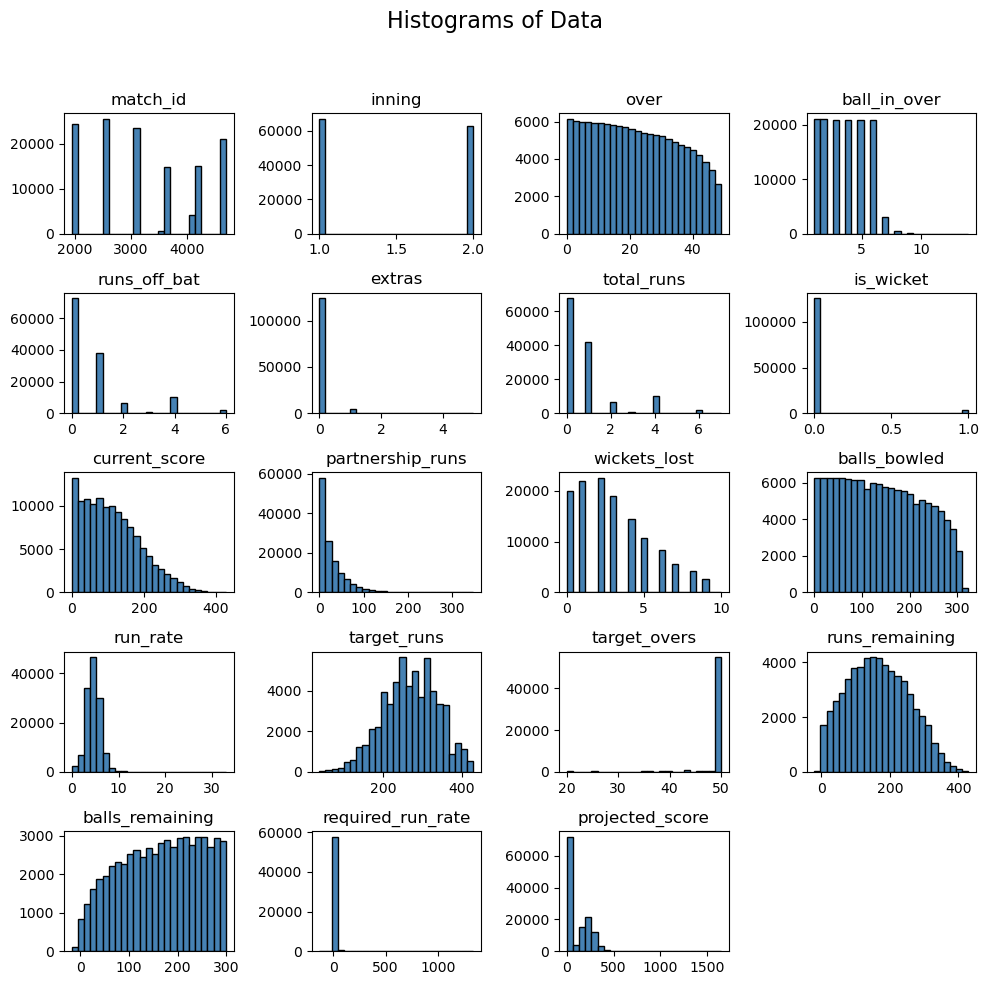

In [358]:
import matplotlib.pyplot as plt
combined_ball_df.hist(bins = 25, color='steelblue', edgecolor='black', grid=False , figsize = (10, 10) )
# Add titles and labels
plt.suptitle('Histograms of Data', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust spacing between subplots
plt.xlabel('Value', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Modify tick font size
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Remove outer spines
for spine in plt.gca().spines.values():
    spine.set_visible(False)


plt.show()

In [359]:
combined_ball_df = combined_ball_df.fillna(value=0)

combined_ball_df.isna().sum().sum()

0

In [360]:
import numpy as np

log_cols = ['total_runs', 'current_score', 'partnership_runs',
            'run_rate', 'required_run_rate', 'projected_score',
            'runs_remaining', 'extras']

for col in log_cols:
    # Apply log1p, which safely handles zeros and negatives
    combined_ball_df[col] = combined_ball_df[col].apply(lambda x: np.log1p(x) if x > 0 else 0)


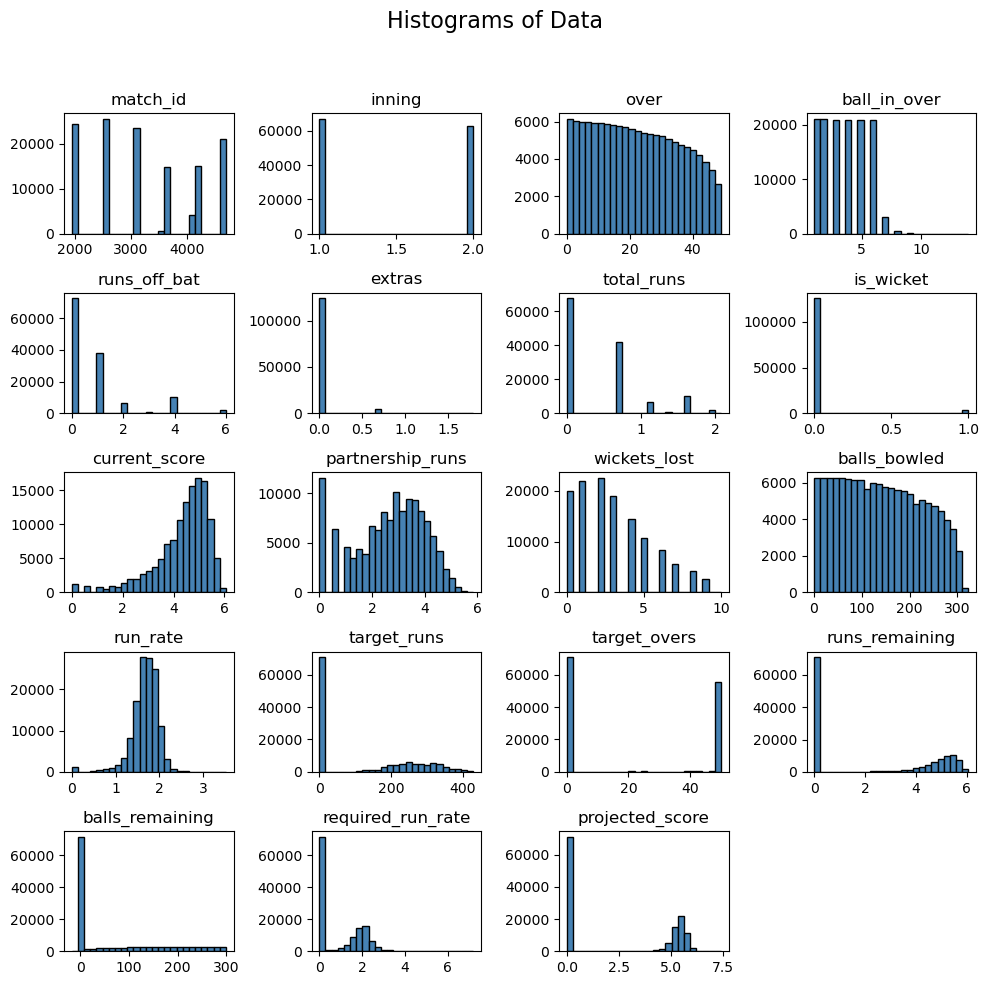

In [361]:
import matplotlib.pyplot as plt
combined_ball_df.hist(bins = 25, color='steelblue', edgecolor='black', grid=False , figsize = (10, 10) )
# Add titles and labels
plt.suptitle('Histograms of Data', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust spacing between subplots
plt.xlabel('Value', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Modify tick font size
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Remove outer spines
for spine in plt.gca().spines.values():
    spine.set_visible(False)


plt.show()

In [362]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create subplots for the histograms (3x3 layout)
fig = make_subplots(
    rows=3, cols=3,
    subplot_titles=[
        'batting_team', 'bowling_team', 'batter',
        'bowler', 'wicket_type', 'player_out',
        'pressure_index', 'winner', 'expected_winner'
    ]
)

# Add histograms to corresponding subplot
fig.add_trace(go.Histogram(x=combined_ball_df['batting_team']), row=1, col=1)
fig.add_trace(go.Histogram(x=combined_ball_df['bowling_team']), row=1, col=2)
fig.add_trace(go.Histogram(x=combined_ball_df['batter']), row=1, col=3)

fig.add_trace(go.Histogram(x=combined_ball_df['bowler']), row=2, col=1)
fig.add_trace(go.Histogram(x=combined_ball_df['wicket_type']), row=2, col=2)
fig.add_trace(go.Histogram(x=combined_ball_df['player_out']), row=2, col=3)

fig.add_trace(go.Histogram(x=combined_ball_df['pressure_index']), row=3, col=1)
fig.add_trace(go.Histogram(x=combined_ball_df['winner']), row=3, col=2)
fig.add_trace(go.Histogram(x=combined_ball_df['expected_winner']), row=3, col=3)

# Update layout
fig.update_layout(
    title_text="Ball-Level Categorical Feature Distributions",
    showlegend=False,
    height=1000
)

fig.show()


In [363]:
columns_to_encode = []
for i in combined_ball_df.columns:
    if combined_ball_df[i].dtype == 'O':
        print (i)
        columns_to_encode.append(i)

batting_team
bowling_team
batter
bowler
wicket_type
player_out
pressure_index
winner
expected_winner


In [364]:
# Replace 0 with '0' in specific columns
combined_ball_df[['wicket_type', 'player_out', 'pressure_index']] = combined_ball_df[['wicket_type', 'player_out', 'pressure_index']].applymap(lambda x: '0' if x == 0 else x)
combined_ball_df[['wicket_type', 'player_out', 'pressure_index']]

,wicket_type,player_out,pressure_index
0,0,0,0
1,caught,JM Bairstow,0
2,0,0,0
3,0,0,0
4,0,0,0
...,...,...,...
129392,0,0,0
129393,0,0,0
129394,0,0,0
129395,0,0,0


In [365]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
import pickle

encoders = []

for col in columns_to_encode:
    le = LabelEncoder()
    combined_ball_df[col] = le.fit_transform(combined_ball_df[col])
    encoders.append(le)
    sc = StandardScaler()
    # combined_ball_df['year'] = sc.fit_transform(combined_ball_df['year'].values.reshape(-1, 1))
    # encoders.append(sc)

# Save the list of encoders
with open('Ball_DF_encoders_list.pkl', 'wb') as f:
    pickle.dump(encoders, f)


combined_ball_df

,match_id,inning,batting_team,bowling_team,over,ball_in_over,batter,bowler,runs_off_bat,extras,total_runs,is_wicket,wicket_type,player_out,current_score,partnership_runs,wickets_lost,balls_bowled,run_rate,target_runs,target_overs,runs_remaining,balls_remaining,required_run_rate,projected_score,pressure_index,winner,expected_winner
0,4143,1,4,13,0,1,287,175,1,0.000000,0.693147,0,0,0,0.693147,0.693147,0,1,1.945910,0.0,0.0,0.000000,0.0,0.0,0.000000,0,3,10
1,4143,1,4,13,0,2,292,175,0,0.000000,0.000000,1,2,281,0.693147,0.000000,1,2,1.386294,0.0,0.0,0.000000,0.0,0.0,0.000000,0,3,10
2,4143,1,4,13,0,3,277,175,0,0.000000,0.000000,0,0,0,0.693147,0.000000,1,3,1.098612,0.0,0.0,0.000000,0.0,0.0,0.000000,0,3,10
3,4143,1,4,13,0,4,277,175,0,0.000000,0.000000,0,0,0,0.693147,0.000000,1,4,0.916291,0.0,0.0,0.000000,0.0,0.0,0.000000,0,3,10
4,4143,1,4,13,0,5,277,175,0,0.000000,0.000000,0,0,0,0.693147,0.000000,1,5,0.788457,0.0,0.0,0.000000,0.0,0.0,0.000000,0,3,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129392,3644,1,10,13,42,1,157,121,0,0.693147,0.693147,0,0,0,5.662960,2.890372,6,258,2.037893,298.0,43.0,2.484907,0.0,0.0,5.662960,0,8,8
129393,3644,1,10,13,42,2,202,121,1,0.000000,0.693147,0,0,0,5.666427,2.944439,6,259,2.037553,298.0,43.0,2.397895,-1.0,0.0,5.662572,0,8,8
129394,3644,1,10,13,42,3,157,121,4,0.000000,1.609438,0,0,0,5.680173,3.135494,6,260,2.046203,298.0,43.0,1.945910,-2.0,0.0,5.672477,0,8,8
129395,3644,1,10,13,42,4,157,121,0,0.693147,0.693147,0,0,0,5.683580,3.135494,6,261,2.045837,298.0,43.0,1.791759,-3.0,0.0,5.672058,0,8,8


In [366]:
from sklearn.preprocessing import StandardScaler

scale = ['current_score', 'partnership_runs', 'wickets_lost', 'balls_bowled', 'run_rate', 'required_run_rate', 'projected_score']
sc = StandardScaler()  # Instantiate the scaler
combined_ball_df[scale] = sc.fit_transform(combined_ball_df[scale])
with open('Ball_DF_scaler_list.pkl', 'wb') as f:
    pickle.dump(sc, f)

In [367]:
combined_ball_df.to_csv('combined_ball_df.csv', index=False)

In [368]:
from sklearn.feature_selection import SelectKBest, f_classif

# Drop columns that shouldn't be in X (like target or identifiers)
X = combined_ball_df.drop(columns=['winner'])  # or whatever your target is
y = combined_ball_df['winner']  # target column (should be encoded as numeric if it's categorical)


In [369]:
X.drop('match_id'  ,axis=1 , inplace=True)

# Select top k features
k = 15  # or any number of top features you want
selector = SelectKBest(score_func=f_classif, k=k)
X_new = selector.fit_transform(X, y)

# Get selected feature names
mask = selector.get_support()
selected_features = X.columns[mask]
print("Top Features:\n", selected_features)


Top Features:
 Index(['batting_team', 'bowling_team', 'over', 'batter', 'bowler',
       'runs_off_bat', 'total_runs', 'current_score', 'partnership_runs',
       'wickets_lost', 'run_rate', 'target_runs', 'required_run_rate',
       'pressure_index', 'expected_winner'],
      dtype='object')


In [370]:
xtrain , xtest , ytrain , ytest = train_test_split(X_new , y , train_size=0.90)
xtrain

array([[13.        , 16.        , 16.        , ..., -0.84290179,
         0.        , 10.        ],
       [ 5.        , 11.        , 18.        , ..., -0.84290179,
         0.        ,  4.        ],
       [ 0.        , 10.        , 47.        , ..., -0.84290179,
         0.        ,  0.        ],
       ...,
       [14.        ,  1.        , 19.        , ..., -0.84290179,
         0.        ,  1.        ],
       [13.        , 10.        , 30.        , ...,  0.87197795,
         2.        ,  8.        ],
       [ 0.        , 16.        , 47.        , ..., -0.84290179,
         0.        ,  0.        ]])

In [371]:
# from sklearn.linear_model import LogisticRegression
# from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
# from sklearn.svm import SVC
# from sklearn.neighbors import KNeighborsClassifier
# from sklearn.metrics import accuracy_score
# import lightgbm as lgb
# import xgboost as xgb

# models = {
#     'Logistic Regression': LogisticRegression(max_iter=1000),
#     'Random Forest': RandomForestClassifier(),
#     'Gradient Boosting': GradientBoostingClassifier(),
#     'SVM': SVC(probability=True),
#     'KNN': KNeighborsClassifier(),
#     'LightGBM': lgb.LGBMClassifier(),
#     'AdaBoost': AdaBoostClassifier(),
#     'XGBoost': xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
# }

# for name, model in models.items():
#     model.fit(xtrain, ytrain)
#     preds = model.predict(xtest)
#     acc = accuracy_score(ytest, preds)
#     print(f'{name}: Accuracy = {acc:.4f}')


In [372]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier()
model.fit(xtrain, ytrain)
preds = model.predict(xtest)
acc = accuracy_score(ytest, preds)
print(f'Random Forest: Accuracy = {acc:.4f}')


Random Forest: Accuracy = 0.9999


# Inference

In [373]:
df = pd.read_csv('combined_ball_df.csv')

In [374]:
import pandas as pd
import numpy as np
import pickle


combined_ball_df_copy = combined_ball_df_copy.merge(expected_winner_df, on='match_id', how='left')

# Step 1: Load Encoders and Scaler from Pickle Files
with open('Ball_DF_encoders_list.pkl', 'rb') as f:
    Ball_DF_encoders_list = pickle.load(f)

with open('Ball_DF_scaler_list.pkl', 'rb') as f:
    Ball_DF_scaler_list = pickle.load(f)

# Step 2: Define columns
log_cols = ['total_runs', 'current_score', 'partnership_runs',
            'run_rate', 'required_run_rate', 'projected_score',
            'runs_remaining', 'extras']

encode_cols = ['batting_team', 'bowling_team', 'batter', 'bowler',
               'wicket_type', 'player_out', 'pressure_index',
               'winner', 'expected_winner']

scale_cols = ['current_score', 'partnership_runs', 'wickets_lost',
              'balls_bowled', 'run_rate', 'required_run_rate', 'projected_score']

# Step 3: Apply log1p
for col in log_cols:
    combined_ball_df_copy[col] = combined_ball_df_copy[col].apply(lambda x: np.log1p(x) if x > 0 else 0)

# Step 4: Fill NaNs
combined_ball_df_copy = combined_ball_df_copy.fillna(value=0)

# Step 5: Encode categorical columns
for i, col in enumerate(encode_cols):
    encoder = Ball_DF_encoders_list[i]
    combined_ball_df_copy[col] = encoder.transform(combined_ball_df_copy[col].astype(str))

# Step 6: Scale numerical columns
scaler = Ball_DF_scaler_list
combined_ball_df_copy[scale_cols] = scaler.transform(combined_ball_df_copy[scale_cols])


top_features = [
    'batting_team', 'bowling_team', 'over', 'batter', 'bowler',
    'runs_off_bat', 'total_runs', 'current_score', 'partnership_runs',
    'wickets_lost', 'run_rate', 'target_runs', 'required_run_rate',
    'pressure_index', 'expected_winner'
]

combined_ball_df_copy = combined_ball_df_copy[top_features]


In [375]:
combined_ball_df_copy

,batting_team,bowling_team,over,batter,bowler,runs_off_bat,total_runs,current_score,partnership_runs,wickets_lost,run_rate,target_runs,required_run_rate,pressure_index,expected_winner
0,4,13,0,287,175,1,0.693147,-3.383070,-1.464027,-1.255588,0.846376,0.0,-0.842902,0,10
1,4,13,0,292,175,0,0.000000,-3.383070,-1.980091,-0.831755,-0.929530,0.0,-0.842902,0,10
2,4,13,0,277,175,0,0.000000,-3.383070,-1.980091,-0.831755,-1.842472,0.0,-0.842902,0,10
3,4,13,0,277,175,0,0.000000,-3.383070,-1.980091,-0.831755,-2.421058,0.0,-0.842902,0,10
4,4,13,0,277,175,0,0.000000,-3.383070,-1.980091,-0.831755,-2.826730,0.0,-0.842902,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129392,10,13,42,157,121,0,0.693147,1.220065,0.171858,1.287413,1.138276,298.0,-0.842902,0,8
129393,10,13,42,202,121,1,0.693147,1.223276,0.212113,1.287413,1.137199,298.0,-0.842902,0,8
129394,10,13,42,157,121,4,1.609438,1.236008,0.354358,1.287413,1.164649,298.0,-0.842902,0,8
129395,10,13,42,157,121,0,0.693147,1.239163,0.354358,1.287413,1.163488,298.0,-0.842902,0,8


In [381]:
print(model.predict(combined_ball_df_copy.iloc[[129396]]))


[8]


c:\Users\Hp\anaconda3\lib\site-packages\sklearn\base.py:432: UserWarning:

X has feature names, but RandomForestClassifier was fitted without feature names



In [383]:
print("Numbered Mappings:")
for i, class_label in enumerate(Ball_DF_encoders_list[7].classes_):
    print(f"{i}: {class_label}")


Numbered Mappings:
0: Australia
1: Bangladesh
2: Canada
3: England
4: India
5: Ireland
6: Kenya
7: Netherlands
8: New Zealand
9: Pakistan
10: South Africa
11: Sri Lanka
12: West Indies
13: Zimbabwe
